In [ ]:
%load_ext tensorboard

In [ ]:
#import libraries for preprocessing
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

In [ ]:
# TASK-1 LOAD THE DATA (i've unzipped the data zip file in my drive already)
dataset_path = "/content/drive/My Drive/animal_dataset_intermediate"

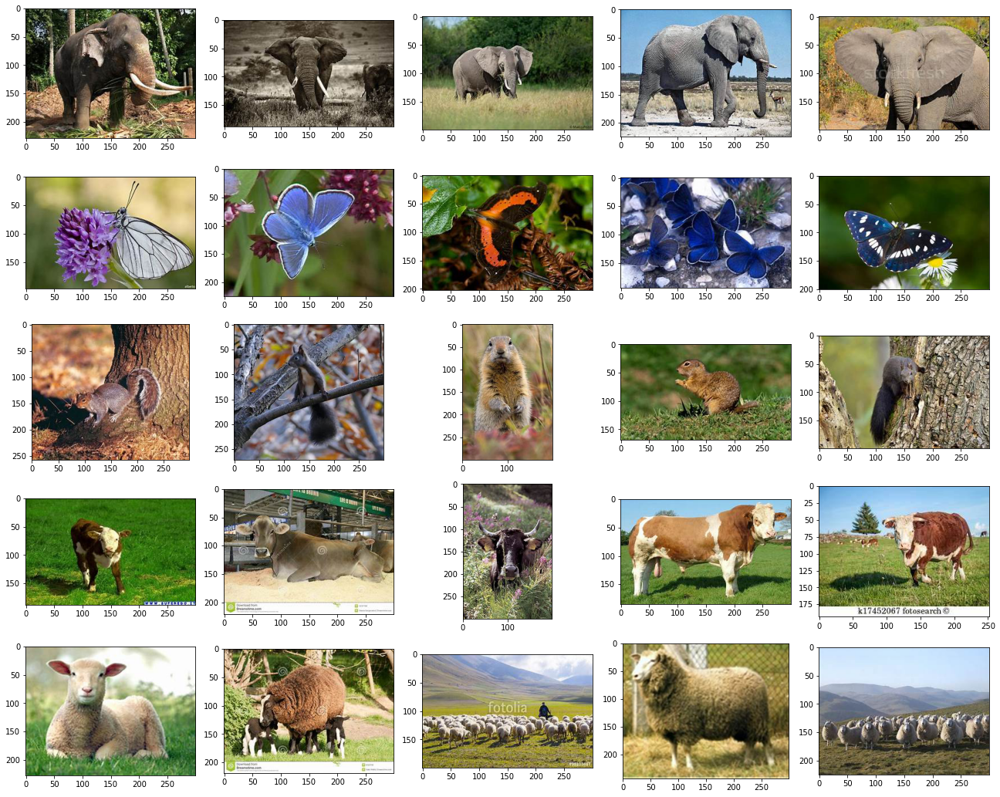

In [ ]:
#let's see some of our images from the train directory
train_path = "/content/drive/My Drive/animal_dataset_intermediate/train" #train folder directory
from tensorflow.keras.preprocessing.image import load_img
plt.figure(0, figsize=(18,20))
cpt=0
pic_size = 48
for image in os.listdir(train_path):
    for i in range(1,6):
        cpt = cpt +1
        plt.subplot(7,5,cpt)
        img = load_img(train_path +'/' + image + '/' + os.listdir(train_path + '/' + image)[i])
        plt.imshow(img)
plt.tight_layout()
plt.show()

we can observe that our images are not in the same dimentions and there's no way we would train a neural network with these sets of images so we need to have an even dimension. to resize the images, we can use the opencv but i'm more comfortable with the keras imagedatagenerator module, so i'd be using that to resize, scale and also augument my images


In [ ]:
#TASK-2 DATA PREPROCESSING
train_path = "/content/drive/My Drive/animal_dataset_intermediate/train"
from keras.preprocessing.image import ImageDataGenerator
datagen = ImageDataGenerator(rescale=1./255,
            rotation_range=30,
            width_shift_range=0.1,
            height_shift_range=0.1,
            shear_range=0.1,
            zoom_range=0.1,
            horizontal_flip=True, 
            validation_split=0.2)
train_data = datagen.flow_from_directory(train_path,
                                         target_size=(224,224),
    batch_size=64,
    class_mode='categorical',
    shuffle=True,
    subset='training')
test_data = datagen.flow_from_directory(
    train_path, # same directory as training data
    target_size=(224,224),
    batch_size=64,
    class_mode='categorical',
    shuffle=False,
    subset='validation')


Found 6558 images belonging to 5 classes.
Found 1638 images belonging to 5 classes.


in the cell above, we have used the image data generator to resize our images to 224,224. the reason why i chose 224 is because the original images are not even so some have a larger pixel values and some have smaller, i do not want to shrink the images too much so we dont loose important informations. and also because we have a small dataset, the image data generator would help us augument the data during training. we have also scaled our images since the images are in rgb mode, we used a scale of 1/255 which would make the values between 0 and 1. i also spllited the training set into 2 for training and validation so we can monitor our model's progress


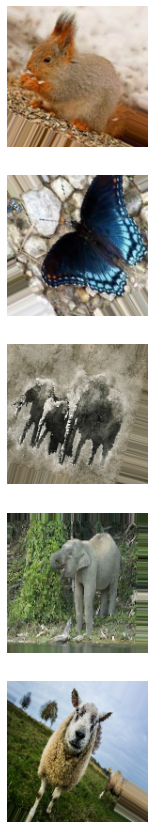

In [ ]:
#let's view some of the images from our imagedatagenerator to see if it's been resized
def plotImages(images_arr):
    fig, axes = plt.subplots(len(images_arr), 1, figsize=(5,len(images_arr) * 3))    
    for img, ax in zip(images_arr, axes):
      ax.imshow(img)          
      ax.axis('off')              
    plt.show()
samples, _ = next(train_data)
plotImages(samples[:5])

we can see that the images have been resized evenly, lets see the augumented images

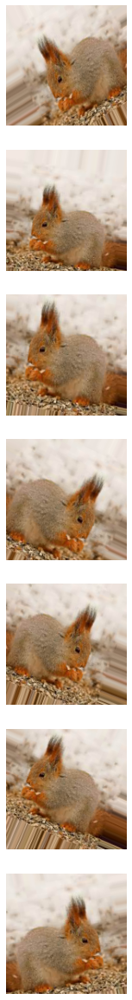

In [ ]:
augmented_images = [train_data[0][0][0] for i in range(7)]
plotImages(augmented_images)

In [ ]:
#TASK-3 BUILD A MULTILAYER PERCEPTRON
#importing the libraries for building a model
import tensorflow as tf
import keras as k
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten

In [ ]:
#bulding the model
from keras.layers import BatchNormalization
Model = Sequential()
Model.add(Flatten(input_shape=(224,224, 3)))
Model.add(Dense(32, activation='relu'))
Model.add(BatchNormalization())
Model.add(Dense(32, activation='relu'))
Model.add(BatchNormalization())
Model.add(Dense(64, activation='relu'))
Model.add(BatchNormalization())
Model.add(Dense(64, activation='relu'))
Model.add(BatchNormalization())
Model.add(Dense(128, activation='relu'))
Model.add(BatchNormalization())
Model.add(Dense(128, activation='relu'))
Model.add(BatchNormalization())
Model.add(Dense(512, activation='relu'))
Model.add(BatchNormalization())
Model.add(Dropout(0.5))
Model.add(Dense(5, activation='softmax'))
Model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_4 (Flatten)          (None, 67500)             0         
_________________________________________________________________
dense_25 (Dense)             (None, 32)                2160032   
_________________________________________________________________
batch_normalization_7 (Batch (None, 32)                128       
_________________________________________________________________
dense_26 (Dense)             (None, 32)                1056      
_________________________________________________________________
batch_normalization_8 (Batch (None, 32)                128       
_________________________________________________________________
dense_27 (Dense)             (None, 64)                2112      
_________________________________________________________________
batch_normalization_9 (Batch (None, 64)               

In [ ]:
#compiling the model
from keras.optimizers import Adam #i am using adam because it is computationally efficient and requires little tuning
adam = Adam(lr=0.001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08) #this is the default recommended value by keras
Model.compile(loss='categorical_crossentropy', metrics=['accuracy'],optimizer=adam)



lr is the learning rate and it's pretty traditional to start with 0.001, we can tune this after we train our model
beta_1 is the exponential decay rate for the first moment estimates and beta_2 is exponential decay rate for the second-moment estimates
epsilon is Is a very small number to prevent any division by zero in the implementation
the metrics accuracy is what is used since it's a cassification problem
loss is also set to categorical_crossentropy because our our target is set to a 2d one hot encoded variable by our imagedatagenerator.

In [ ]:
#now lets train our neural network to see
import datetime
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)
history = Model.fit(train_data, epochs=50, validation_data=test_data, callbacks=[tensorboard_callback])
#we've set our batch size already in the image data generator to 640

Epoch 1/50
103/103 [==============================] - 67s 647ms/step - loss: 2.1185 - accuracy: 0.2832 - val_loss: 1.6744 - val_accuracy: 0.2289
Epoch 2/50
103/103 [==============================] - 66s 644ms/step - loss: 1.8230 - accuracy: 0.3103 - val_loss: 1.4883 - val_accuracy: 0.3468
Epoch 3/50
103/103 [==============================] - 66s 637ms/step - loss: 1.6303 - accuracy: 0.3439 - val_loss: 1.6522 - val_accuracy: 0.2857
Epoch 4/50
103/103 [==============================] - 66s 639ms/step - loss: 1.5211 - accuracy: 0.3701 - val_loss: 1.4728 - val_accuracy: 0.3553
Epoch 5/50
103/103 [==============================] - 66s 641ms/step - loss: 1.4545 - accuracy: 0.3930 - val_loss: 1.4126 - val_accuracy: 0.4103
Epoch 6/50
103/103 [==============================] - 66s 639ms/step - loss: 1.4031 - accuracy: 0.4082 - val_loss: 1.3426 - val_accuracy: 0.4451
Epoch 7/50
103/103 [==============================] - 67s 650ms/step - loss: 1.3658 - accuracy: 0.4251 - val_loss: 1.3145 - val_ac

accuracy of the MLP model without dropout at 20 epochs was 45%
accuracy of MLP model with batch normalization trained at 50 epochs gave 50% accuracy

In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 1771), started 1:02:14 ago. (Use '!kill 1771' to kill it.)

<IPython.core.display.Javascript object>

from our MLP model above, we are clearly not overfitting but the highest accuracy achieved is 50% even with batch normalization and dropouts

In [ ]:
#importing libraries for our CNN network
from keras.layers import Conv2D, MaxPool2D
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, BatchNormalization
import datetime
import tensorflow as tf

In [ ]:
#building our CNN model
model = Sequential()
#first convo block by 32filters
model.add(Conv2D(32, (3,3), activation='relu', input_shape=(224,224,3), padding='same'))
model.add(BatchNormalization())
#second convo block by 32filters
model.add(Conv2D(32,(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2,2)))
#third convo block with 64 filters
model.add(Conv2D(64,(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
#fourth convo block with 64 filters
model.add(Conv2D(64,(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2,2)))
#fifth  conv block with 128 filters
model.add(Conv2D(128, (3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2,2)))
#flatten
model.add(Flatten())
#fully connected layer
model.add(Dense(512, activation='relu'))
model.add(BatchNormalization())
#output layer
model.add(Dense(5, activation='softmax'))

model.summary()


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 150, 150, 32)      896       
_________________________________________________________________
batch_normalization (BatchNo (None, 150, 150, 32)      128       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 150, 150, 32)      9248      
_________________________________________________________________
batch_normalization_1 (Batch (None, 150, 150, 32)      128       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 75, 75, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 75, 75, 64)        18496     
_________________________________________________________________
batch_normalization_2 (Batch (None, 75, 75, 64)        2

In [ ]:
#compiling the model, we'll use the same loss function and optimizer as in our MLP model
model.compile(loss='categorical_crossentropy', metrics=['accuracy'],optimizer='adam')


In [ ]:
#training our CNN model with callbacks and logs
import datetime
import tensorflow as tf
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)
history2 = model.fit(train_data, epochs=50, validation_data=test_data, callbacks=[tensorboard_callback])

Epoch 1/50
  1/103 [..............................] - ETA: 1s - loss: 2.1717 - accuracy: 0.1562WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
103/103 [==============================] - 4376s 42s/step - loss: 1.3453 - accuracy: 0.5441 - val_loss: 2.5704 - val_accuracy: 0.2112
Epoch 2/50
103/103 [==============================] - 81s 785ms/step - loss: 0.8826 - accuracy: 0.6586 - val_loss: 12.3750 - val_accuracy: 0.2210
Epoch 3/50
103/103 [==============================] - 80s 776ms/step - loss: 0.7777 - accuracy: 0.7007 - val_loss: 2.6755 - val_accuracy: 0.2717
Epoch 4/50
103/103 [==============================] - 79s 772ms/step - loss: 0.7782 - accuracy: 0.6998 - val_loss: 1.9912 - val_accuracy: 0.3425
Epoch 5/50
103/103 [==============================] - 80s

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

we observed an accuracy of 62% with our CNN model without batch normalization. 79% with batch normalization and maxpool, adam optimizer and categorical_crossentropy loss..this is still fair enough and better than our MLP model

In [ ]:
#i want to try transfer learning to see if we can get a much better accuracy
pretrained_model = tf.keras.applications.MobileNetV2(input_shape=[224,224,3], include_top=False)
pretrained_model.trainable = False

TL_model = tf.keras.Sequential([
    pretrained_model,
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(5, activation='softmax')
])

9412608/9406464 [==============================] - 0s 0us/step


In [ ]:
TL_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Functi (None, 7, 7, 1280)        2257984   
_________________________________________________________________
flatten (Flatten)            (None, 62720)             0         
_________________________________________________________________
dense (Dense)                (None, 5)                 313605    
Total params: 2,571,589
Trainable params: 313,605
Non-trainable params: 2,257,984
_________________________________________________________________


In [ ]:
#compiling the transfer learning model
TL_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
#training our transfer learning model
EPOCHS = 100
es_callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2, 
                                               restore_best_weights=True,
                                               verbose=1)

history = TL_model.fit(train_data,
                    validation_data=test_data, epochs=EPOCHS,
                     callbacks=[es_callback],
                    verbose=1)


Epoch 1/100
103/103 [==============================] - 5329s 52s/step - loss: 1.4539 - accuracy: 0.8850 - val_loss: 1.6305 - val_accuracy: 0.8858
Epoch 2/100
103/103 [==============================] - 113s 1s/step - loss: 0.8325 - accuracy: 0.9308 - val_loss: 1.1079 - val_accuracy: 0.9212
Epoch 3/100
103/103 [==============================] - 113s 1s/step - loss: 0.7100 - accuracy: 0.9453 - val_loss: 0.8838 - val_accuracy: 0.9322
Epoch 4/100
103/103 [==============================] - 112s 1s/step - loss: 0.7496 - accuracy: 0.9471 - val_loss: 1.2102 - val_accuracy: 0.9237
Epoch 5/100
103/103 [==============================] - 115s 1s/step - loss: 0.6191 - accuracy: 0.9532 - val_loss: 1.5588 - val_accuracy: 0.9133
Epoch 00005: early stopping


training the model with early stopping prevents overfitting. this transfer learning procedure model gave an accuracy of 94%.
adding an additional layer of dense with batchnormalization gave an accuracy of 95



In [ ]:
pretrained_model = tf.keras.applications.MobileNetV2(input_shape=[224,224,3], include_top=False)
pretrained_model.trainable = False

TL_model2 = tf.keras.Sequential([
    pretrained_model,
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(5, activation='softmax')
])
TL_model2.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Functi (None, 7, 7, 1280)        2257984   
_________________________________________________________________
flatten_3 (Flatten)          (None, 62720)             0         
_________________________________________________________________
dense_5 (Dense)              (None, 256)               16056576  
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 5)                 1285      
Total params: 18,315,845
Trainable params: 16,057,861
Non-trainable params: 2,257,984
_________________________________________________________________


In [ ]:
TL_model2.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
EPOCHS = 100
es_callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2, 
                                               restore_best_weights=True,
                                               verbose=1)

history = TL_model2.fit(train_data,
                    validation_data=test_data, epochs=EPOCHS,
                     callbacks=[es_callback],
                    verbose=1)

Epoch 1/100
103/103 [==============================] - 113s 1s/step - loss: 1.2353 - accuracy: 0.8800 - val_loss: 0.2514 - val_accuracy: 0.9103
Epoch 2/100
103/103 [==============================] - 112s 1s/step - loss: 0.2665 - accuracy: 0.9091 - val_loss: 0.1944 - val_accuracy: 0.9261
Epoch 3/100
103/103 [==============================] - 112s 1s/step - loss: 0.2247 - accuracy: 0.9257 - val_loss: 0.2433 - val_accuracy: 0.9255
Epoch 4/100
103/103 [==============================] - 115s 1s/step - loss: 0.2106 - accuracy: 0.9280 - val_loss: 0.2254 - val_accuracy: 0.9328
Epoch 00004: early stopping


In [ ]:
#load the image files in the order of the testing and set animals and resize
import cv2
test_file=pd.read_csv('Testing_set_animals.csv')
test_image=[]
for i in test_file['filename']:
  image= cv2.imread('/content/drive/My Drive/animal_dataset_intermediate/test/'+i)
  r = cv2.resize(image, (224, 224))
  test_image.append(r)

In [ ]:
#convert it to a numpy array
test_image = np.array(test_image)

In [ ]:
#check the shape
test_image.shape

(910, 224, 224, 3)

In [ ]:
#normalize and center the values between 0 and 1
test_image = test_image/255

In [ ]:
#we are ready to make predictions
predictions = model3.predict(test_image)

In [ ]:
#lets check one of our predictions
np.argmax(predictions[7], axis=-1)

3

In [ ]:
#classes according to the directory
classes = ['elefante', 'farfalla','mucca','pecora', 'scoiattolo']
mapping = {0:'elefante', 1:'farfalla', 2:'mucca', 3:'pecora', 4:'scoiattolo'}

In [ ]:
#store our argmax for all the predictions into pred
pred = []
for i in range(len(predictions)):
  pred.append(np.argmax(predictions[i], axis=-1))

In [ ]:
#convert it to a series for us to map through the values and convert it to the strings
pred = pd.Series(pred)
predsMap = pred.map(mapping)


In [ ]:
#create a variable for our mapped predictions
Ass2=predsMap.to_list()

In [ ]:
#confirm if it was successful
Ass2[2]

'farfalla'

In [ ]:
#save to a csv file and upload your predictions
Ass2 = np.array(Ass2)
Ass2.tofile('ass9.csv', sep=',')